In [1]:
import scanpy as sc

In [2]:
import sys
sys.path.insert(0,'/home/cane/Documents/yoseflab/can/resolVI')
from scvi.external import RESOLVI
import scvi
import matplotlib.pyplot as plt

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
scvi.settings.seed = 0
sc.set_figure_params(dpi=100, dpi_save=300, format='png', frameon=False, vector_friendly=True, fontsize=14, color_map='viridis', figsize=None)
sc.settings.figdir = 'figure2'
plt.rcParams['pdf.fonttype'] = 'truetype'
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['pdf.use14corefonts'] = True 

Global seed set to 0


In [6]:
adata = sc.read_h5ad('stereoseq/mouse_brain.h5ad')

In [7]:
adata.uns

{'bin_size': 1,
 'bin_type': 'cell_bins',
 'key_record': {'cluster': array([], dtype=float64),
  'hvg': array([], dtype=float64),
  'marker_genes': array([], dtype=float64),
  'neighbors': array([], dtype=float64),
  'pca': array([], dtype=float64),
  'umap': array([], dtype=float64)},
 'merged': False,
 'resolution': 500,
 'sn':   batch                sn
 0    -1  SS200000135TL_D1}

In [8]:
adata.X.data = adata.X.data.astype('float32')
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [9]:
adata

AnnData object with n_obs × n_vars = 57133 × 24670
    obs: 'dnbCount', 'area', 'orig.ident', 'x', 'y'
    uns: 'bin_size', 'bin_type', 'key_record', 'merged', 'resolution', 'sn', 'log1p'
    obsm: 'cell_border', 'spatial'
    layers: 'counts'

In [10]:
sc.tl.pca(adata)
sc.pp.neighbors(adata)
adata.obsm['X_tsne'] = sc.tl.umap(adata, copy=True).obsm['X_umap']

2025-01-08 14:44:24.835243: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


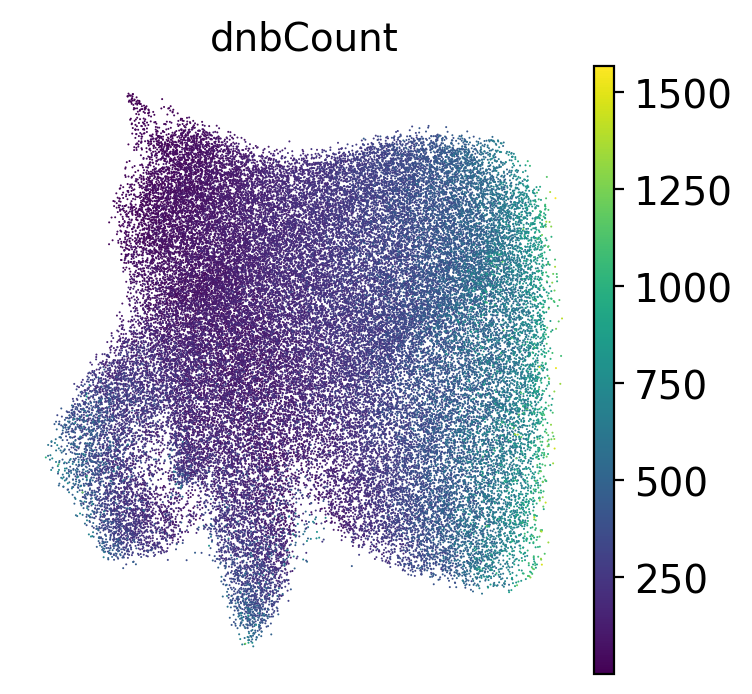

In [11]:
sc.pl.tsne(adata, color='dnbCount')

In [12]:
sc.tl.leiden(adata, key_added='leiden_pca')

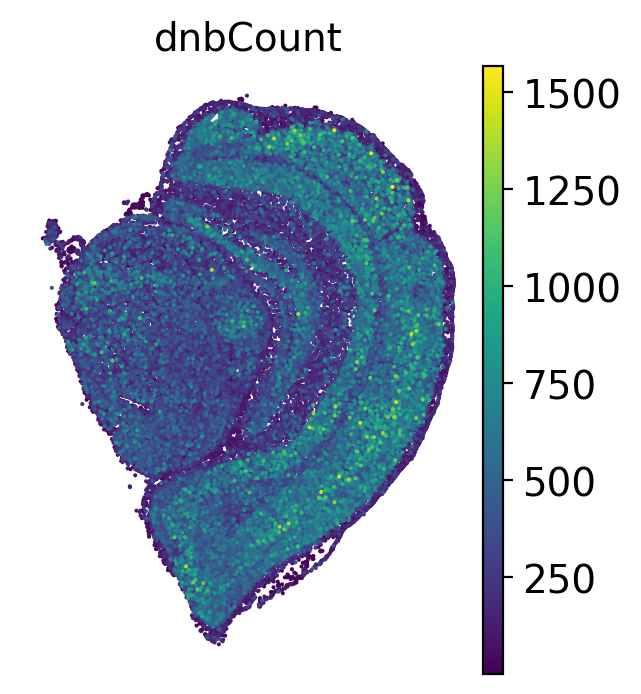

In [13]:
sc.pl.spatial(adata, spot_size=100, color='dnbCount', save='counts_spatial.pdf')

In [14]:
adata.obsm['X_spatial'] = adata.obsm['spatial']

In [15]:
import numpy as np
adata.obs['counts_hvg'] = np.array(adata.layers['counts'].sum(axis=1))

In [16]:
import matplotlib.pyplot as plt
adata = adata[adata.obs['counts_hvg']>10]

In [17]:
retrain = False
if retrain:
    RESOLVI.setup_anndata(adata, layer='counts')
    resolvi = RESOLVI(adata, semisupervised=False)
    resolvi.train()
    fivi
    #resolvi.save('stereoseq_mouse_brain', overwrite=True)
else:
    resolvi = RESOLVI.load('stereoseq/stereoseq_mouse_brain', adata=adata)

INFO     File stereoseq/stereoseq_mouse_brain/model.pt already downloaded                                          


/home/cane/Documents/yoseflab/can/resolVI/scvi/external/resolvi/_model.py:297: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["_indices"] = adata.obs_names.astype(str)
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cudf/utils/_numba.py:110: UserWarning: Using CUDA toolkit version (12, 5) with CUDA driver version (12, 4) requires minor version compatibility, which is not yet supported for CUDA driver versions 12.0 and above. It is likely that many cuDF operations will not work in this state. Please install CUDA toolkit version (12, 4) to continue using cuDF.
  warnings.warn(
<frozen importlib._bootstrap>:241: RuntimeWarning: pyarrow.lib.IpcReadOptions size changed, may indicate binary incompatibility. Expected 96 from C header, got 104 from PyObject
<frozen importlib._bootstrap>:241: RuntimeWarning: pyarrow.lib.Tensor size changed, may indicate binary incompatibility. Expected 64 from C header, got 80

Epoch 1/50:   2%|██                                                                                                   | 1/50 [00:00<00:17,  2.84it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|██                                                                                                   | 1/50 [00:00<00:17,  2.74it/s, v_num=1]


In [18]:
adata.obsm['X_resolvi'] = resolvi.get_latent_representation()

In [19]:
adata = adata[adata.obs['counts_hvg']>50]

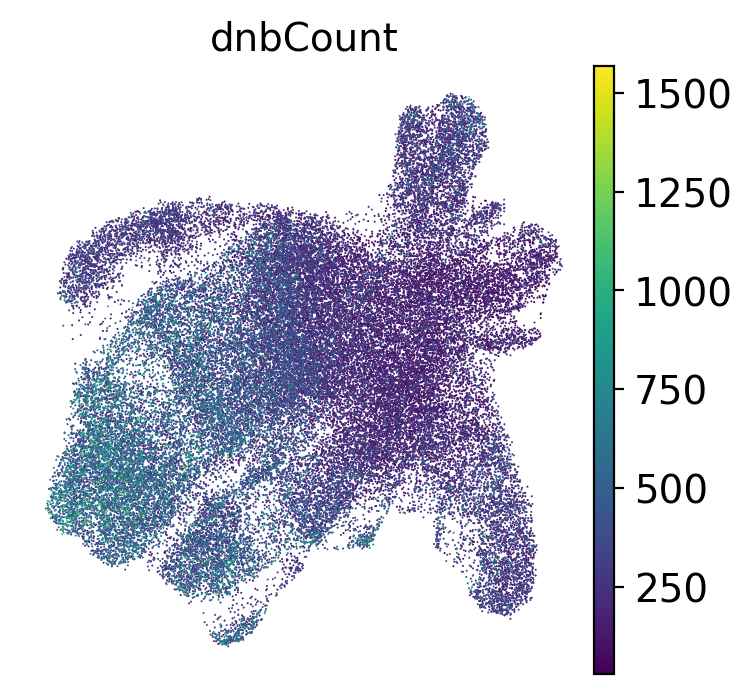

In [20]:
sc.pp.neighbors(adata, use_rep='X_resolvi')
sc.tl.umap(adata)
sc.pl.umap(adata, color='dnbCount')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


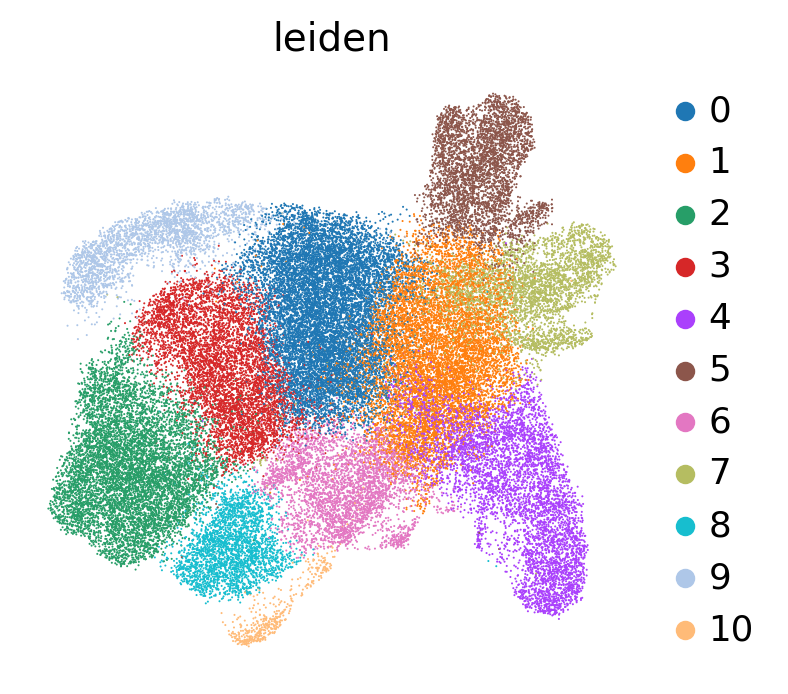

In [21]:
sc.tl.leiden(adata, resolution=0.4)
sc.pl.umap(adata, color='leiden')

In [22]:
try:
    del adata.uns['dendrogram_leiden']
except:
    pass

In [23]:
import pandas as pd

In [20]:
samples_corr = resolvi.sample_posterior_predictive(
    adata=adata,
    model=resolvi.module.model_corrected,
    return_sites=['obs', 'px_rate'],
    summary_fun={"post_sample_q50": np.median},
    num_samples=5, batch_steps=10)
samples_corr = pd.DataFrame(samples_corr).T

INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 2 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_utils.py:240: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[_constants._SCVI_UUID_KEY] = str(uuid4())
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 2 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(


Sampling variables, sample: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 435/435 [04:41<00:00,  1.54it/s]


In [231]:
samples = resolvi.sample_posterior_predictive(
    adata=adata,
    model=resolvi.module.model_residuals,
    return_sites=[
        'mixture_proportions',
        ],
summary_fun={"post_sample_q50": np.median},
num_samples=5, batch_steps=10)
samples = pd.DataFrame(samples).T

INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 2 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_utils.py:240: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[_constants._SCVI_UUID_KEY] = str(uuid4())
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 

Sampling variables, sample: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 435/435 [00:46<00:00,  9.27it/s]


In [232]:
adata.obs[['true_proportion', 'diffusion_proportion', 'background_proportion']] = samples.loc['post_sample_post_sample_q50', 'mixture_proportions']

In [23]:
adata.layers['generated_expression'] = samples_corr.loc['post_sample_post_sample_q50', 'obs']
adata.layers['imputed_expression'] = samples_corr.loc['post_sample_post_sample_q50', 'px_rate']

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


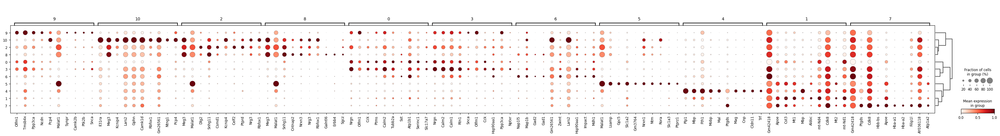

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


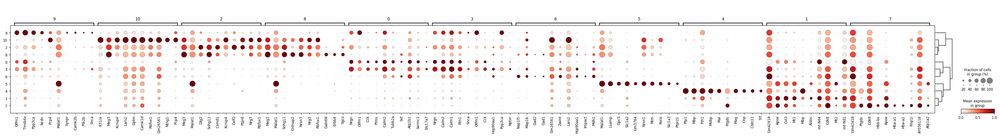

In [203]:
sc.tl.rank_genes_groups(adata, groupby='leiden')
sc.pl.rank_genes_groups_dotplot(adata, layer='counts', standard_scale='var')
sc.pl.rank_genes_groups_dotplot(adata, layer='generated_expression', standard_scale='var')

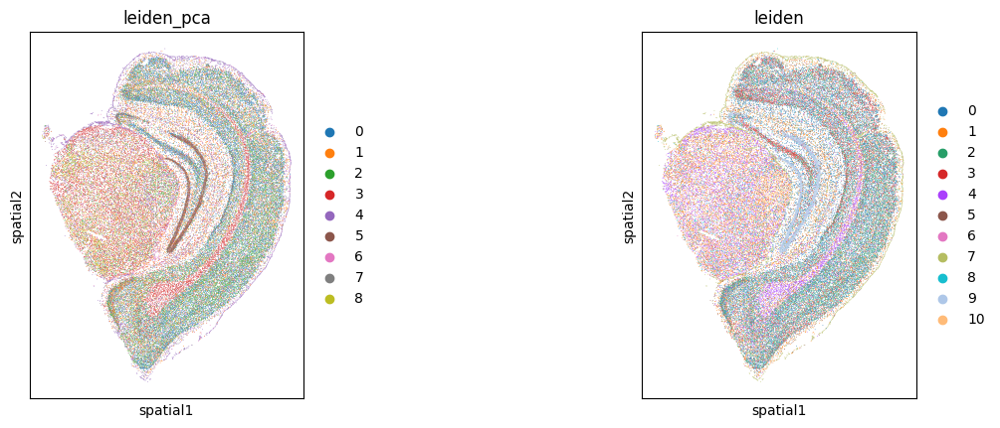

In [204]:
sc.pl.spatial(adata, color=['leiden_pca', 'leiden'], spot_size=30, save='spatial_clusters.pdf')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


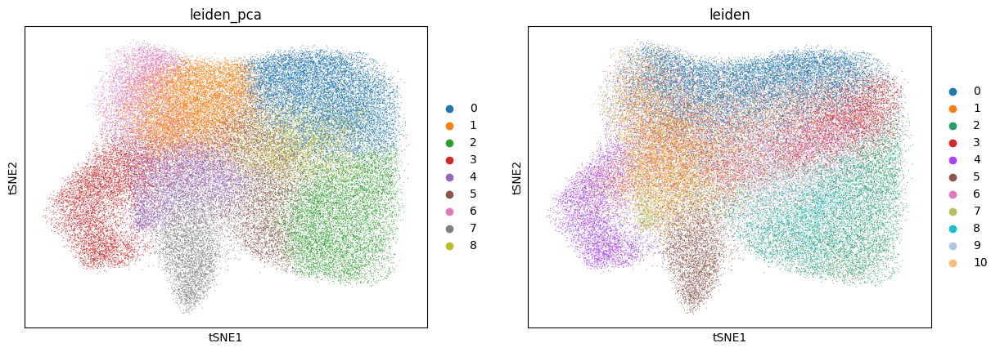

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


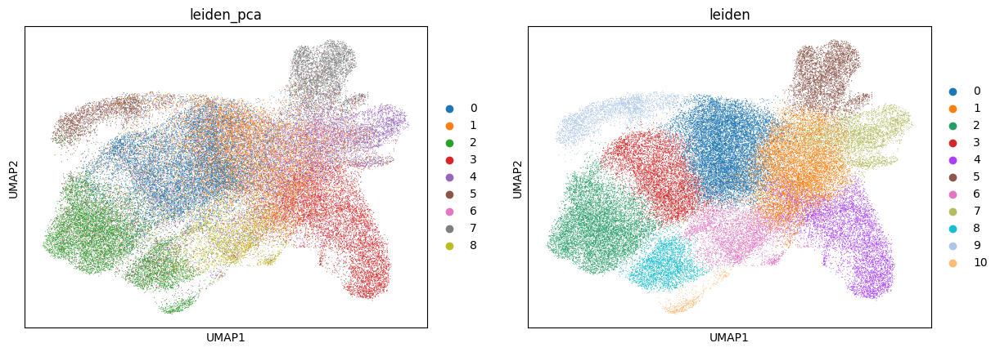

In [206]:
sc.pl.tsne(adata, color=['leiden_pca', 'leiden'], save='umap_clusters.pdf')
sc.pl.umap(adata, color=['leiden_pca', 'leiden'])

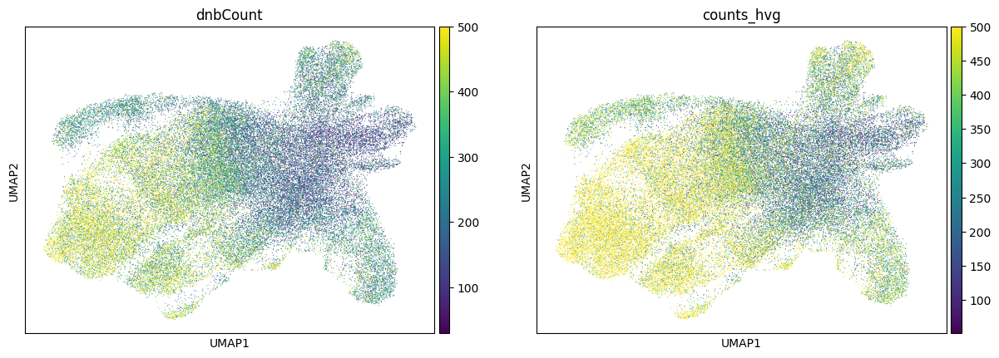

In [207]:
sc.pl.umap(adata, color=['dnbCount', 'counts_hvg'], vmax=500, save='counts.pdf')

In [28]:
adata.write_h5ad('resolvi_processed.h5ad')

In [50]:
adata = sc.read_h5ad('stereoseq/resolvi_processed.h5ad')

In [30]:
single_cell_reference = sc.read_loom('../xenium_brain/single_cell_reference.loom')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_io/read.py:152: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  axis_df[k] = v
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_io/read.py:152: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  axis_df[k] = v
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_io/read.py:152: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor 

In [31]:
adata.var['generated_expression'] = np.array(adata.layers['counts'].sum(0)).flatten()

In [39]:
bdata = adata[:, adata.var['generated_expression']>1000]
bdata

View of AnnData object with n_obs × n_vars = 55577 × 4760
    obs: 'dnbCount', 'area', 'orig.ident', 'x', 'y', 'leiden_pca', 'counts_hvg', '_indices', '_scvi_batch', '_scvi_ind_x', '_scvi_labels', 'leiden'
    var: 'generated_expression'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'bin_size', 'bin_type', 'dendrogram_leiden', 'key_record', 'leiden', 'leiden_colors', 'leiden_pca_colors', 'log1p', 'merged', 'neighbors', 'pca', 'rank_genes_groups', 'resolution', 'sn', 'umap'
    obsm: 'X_pca', 'X_resolvi', 'X_spatial', 'X_tsne', 'X_umap', 'cell_border', 'distance_neighbor', 'index_neighbor', 'spatial'
    varm: 'PCs'
    layers: 'counts', 'generated_expression', 'imputed_expression'
    obsp: 'connectivities', 'distances'

In [40]:
single_cell_reference.var_names_make_unique()
single_cell_reference.obs_names_make_unique()
single_cell_reference = single_cell_reference[:, np.intersect1d(bdata.var_names, single_cell_reference.var_names)].copy()
single_cell_reference

AnnData object with n_obs × n_vars = 160796 × 4654
    obs: 'Age', 'AnalysisPool', 'AnalysisProject', 'Bucket', 'CellConc', 'Cell_Conc', 'ChipID', 'Class', 'ClassProbability_Astrocyte', 'ClassProbability_Astrocyte,Immune', 'ClassProbability_Astrocyte,Neurons', 'ClassProbability_Astrocyte,Oligos', 'ClassProbability_Astrocyte,Vascular', 'ClassProbability_Bergmann-glia', 'ClassProbability_Blood', 'ClassProbability_Blood,Vascular', 'ClassProbability_Enteric-glia', 'ClassProbability_Enteric-glia,Cycling', 'ClassProbability_Ependymal', 'ClassProbability_Ex-Neurons', 'ClassProbability_Ex-Vascular', 'ClassProbability_Immune', 'ClassProbability_Immune,Neurons', 'ClassProbability_Immune,Oligos', 'ClassProbability_Neurons', 'ClassProbability_Neurons,Cycling', 'ClassProbability_Neurons,Oligos', 'ClassProbability_Neurons,Satellite-glia', 'ClassProbability_Neurons,Vascular', 'ClassProbability_OEC', 'ClassProbability_Oligos', 'ClassProbability_Oligos,Cycling', 'ClassProbability_Oligos,Vascular', 'Cla

In [41]:
sc.pp.normalize_total(single_cell_reference, target_sum=1e4)

In [42]:
single_cell_reference.layers['counts'] = single_cell_reference.X.copy()
single_cell_reference.obsm['counts'] = pd.DataFrame(single_cell_reference.layers['counts'].A, columns=single_cell_reference.var_names, index=single_cell_reference.obs_names)

In [43]:
sys.path.insert(0, '..')
import _utils

In [44]:
_utils.double_positive_pmm(single_cell_reference, single_cell_reference.var_names, layer_key="counts", output_dir='.')

Exception ignored in: <function _xla_gc_callback at 0x7ff9866ee8c0>
Traceback (most recent call last):
  File "/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/jax/_src/lib/__init__.py", line 96, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


KeyboardInterrupt: 

In [51]:
single_cell_reference.obsm['positive_pmm_counts']['celltype'] = single_cell_reference.obs['Class']
per_celltype_positive = single_cell_reference.obsm['positive_pmm_counts'].groupby('celltype').mean()
per_celltype_positive.drop('PeripheralGlia', inplace=True)

In [57]:
celltype_gene_dict = {}

# Iterate over each column
for col in per_celltype_positive.columns:
    # Check if only one value is above 0.2 and all other values are below 0.05
    if (per_celltype_positive[col] > 0.05).sum() == 1 and (per_celltype_positive[col] < 0.05).sum() == len(per_celltype_positive) - 1:
        # Get the celltype for which the value is above 0.2
        celltype = per_celltype_positive[per_celltype_positive[col] > 0.05].index[0]
        # If the celltype is not in the result dictionary, add it with an empty list
        if celltype not in celltype_gene_dict:
            celltype_gene_dict[celltype] = []
        # Append the column (gene) to the list of genes for this celltype
        celltype_gene_dict[celltype].append(col)

In [279]:
celltype_gene_dict

{'Ependymal': ['2210408I21Rik',
  'Agbl4',
  'Cmss1',
  'Fzd3',
  'Pttg1',
  'Sorbs1',
  'Vwa8'],
 'Neurons': ['3110035E14Rik',
  '5730409E04Rik',
  'AI593442',
  'Ache',
  'Ackr1',
  'Acsl4',
  'Actl6b',
  'Acvr2a',
  'Adarb2',
  'Adcy1',
  'Adcy9',
  'Add2',
  'Agap2',
  'Ak5',
  'Akap5',
  'Akap6',
  'Ano3',
  'Arfgef3',
  'Arhgap20',
  'Arhgap26',
  'Arl15',
  'Asic2',
  'Asns',
  'Astn2',
  'Atl1',
  'Atp1a3',
  'Atp8a2',
  'Atpaf1',
  'B230217C12Rik',
  'B230334C09Rik',
  'B3galt1',
  'Bcl11a',
  'Bcl11b',
  'Begain',
  'Bend6',
  'Brinp2',
  'Bsn',
  'Cabp1',
  'Cacna1b',
  'Cacna1c',
  'Cacna1e',
  'Cacna2d1',
  'Cacna2d3',
  'Cacnb1',
  'Cacng3',
  'Cadps',
  'Cadps2',
  'Calb2',
  'Caln1',
  'Caly',
  'Camk2a',
  'Camk2n2',
  'Camk4',
  'Camkk1',
  'Camkv',
  'Cap2',
  'Cck',
  'Cdh12',
  'Cdh13',
  'Cdh8',
  'Cdk5r2',
  'Celf5',
  'Chga',
  'Chgb',
  'Chrm1',
  'Chrm3',
  'Ckmt1',
  'Clec2l',
  'Clstn2',
  'Clstn3',
  'Clvs1',
  'Cnih3',
  'Cnr1',
  'Cntn4',
  'Cntn5',
  'Cn

In [280]:
marker_list = sum(celltype_gene_dict.values(), [])

In [281]:
sc.pp.normalize_total(adata, layers=['generated_expression', 'counts'], target_sum=1e4)
adata.obsm['counts'] = pd.DataFrame(adata[:, marker_list].layers['counts'].A, columns=marker_list, index=adata.obs_names)
adata.obsm['generated_expression'] = pd.DataFrame(np.array(adata[:, marker_list].layers['generated_expression']), columns=marker_list, index=adata.obs_names)

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:148: FutureWarning: The `layers` argument is deprecated. Instead, specify individual layers to normalize with `layer`.
  warn(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


In [ ]:
_utils.double_positive_pmm(adata, marker_list, marker_dict=celltype_gene_dict, layer_key="generated_expression", output_dir='.')
plt.show()

In [132]:
full_matrix = adata.uns['double_positive_generated_expression'].copy()

In [133]:
import numpy as np

matrix = full_matrix.copy()
diag_mask = np.eye(matrix.shape[0], dtype=bool)
matrix[diag_mask] = 0
coexpressed_genes = matrix.columns[matrix.max(axis=0) > 0.05]

In [134]:
coexpressed_genes

Index(['Cmss1', 'Adarb2', 'Adcy9', 'Ano3', 'Arfgef3', 'Astn2', 'Atp1a3',
       'Atp8a2', 'B3galt1', 'Bcl11a', 'Cacna1c', 'Cacna2d1', 'Cacna2d3',
       'Camk2n2', 'Camkk1', 'Cck', 'Cdh13', 'Chga', 'Chgb', 'Clstn2', 'Cntn5',
       'Cntnap5a', 'Crmp1', 'Dgkg', 'Dock4', 'Dpp10', 'Elavl2', 'Eml5', 'Eml6',
       'Erc2', 'Fam155a', 'Fam19a1', 'Fam19a2', 'Fgf14', 'Fkbp5', 'Galntl6',
       'Gm20498', 'Gp1bb', 'Gpr158', 'Gpr22', 'Grid1', 'Grin2a', 'Grm1',
       'Grm7', 'Hpca', 'Il1rapl1', 'Ina', 'Kcnb2', 'Kcnip4', 'Kcnj3', 'Kcnma1',
       'Kcnq5', 'Khdrbs2', 'Lhfpl3', 'Lin7b', 'Lrfn5', 'Lrrc7', 'Lrrtm3',
       'Lrrtm4', 'Nefm', 'Nrg1', 'Nrg3', 'Nrgn', 'Pdzrn4', 'Prkar1b', 'Prkcg',
       'Ptpn5', 'Ptprj', 'Rab26', 'Ralyl', 'Rasgef1a', 'Rgs7', 'Rims1',
       'Rims2', 'Robo1', 'Robo2', 'Shisa6', 'Slc17a7', 'Slit3', 'Sntg1', 'Sst',
       'Syp', 'Syt1', 'Tenm2', 'Ttc9b', 'Unc5d', 'Vsnl1', 'Plp1', 'Gpc5',
       'C1qa', 'Csf1r', 'Ctss', 'Hexb', 'Filip1l', 'Ly6c1'],
      dtype='object')

In [135]:
celltype_gene_dict_sub = {k: [gene for gene in v if gene in coexpressed_genes] for k, v in celltype_gene_dict.items()}

print(celltype_gene_dict_sub)

{'Ependymal': ['Cmss1'], 'Neurons': ['Adarb2', 'Adcy9', 'Ano3', 'Arfgef3', 'Astn2', 'Atp1a3', 'Atp8a2', 'B3galt1', 'Bcl11a', 'Cacna1c', 'Cacna2d1', 'Cacna2d3', 'Camk2n2', 'Camkk1', 'Cck', 'Cdh13', 'Chga', 'Chgb', 'Clstn2', 'Cntn5', 'Cntnap5a', 'Crmp1', 'Dgkg', 'Dock4', 'Dpp10', 'Elavl2', 'Eml5', 'Eml6', 'Erc2', 'Fam155a', 'Fam19a1', 'Fam19a2', 'Fgf14', 'Fkbp5', 'Galntl6', 'Gm20498', 'Gp1bb', 'Gpr158', 'Gpr22', 'Grid1', 'Grin2a', 'Grm1', 'Grm7', 'Hpca', 'Il1rapl1', 'Ina', 'Kcnb2', 'Kcnip4', 'Kcnj3', 'Kcnma1', 'Kcnq5', 'Khdrbs2', 'Lhfpl3', 'Lin7b', 'Lrfn5', 'Lrrc7', 'Lrrtm3', 'Lrrtm4', 'Nefm', 'Nrg1', 'Nrg3', 'Nrgn', 'Pdzrn4', 'Prkar1b', 'Prkcg', 'Ptpn5', 'Ptprj', 'Rab26', 'Ralyl', 'Rasgef1a', 'Rgs7', 'Rims1', 'Rims2', 'Robo1', 'Robo2', 'Shisa6', 'Slc17a7', 'Slit3', 'Sntg1', 'Sst', 'Syp', 'Syt1', 'Tenm2', 'Ttc9b', 'Unc5d', 'Vsnl1'], 'Oligos': ['Plp1'], 'Astrocytes': ['Gpc5'], 'Immune': ['C1qa', 'Csf1r', 'Ctss', 'Hexb'], 'Vascular': ['Filip1l', 'Ly6c1']}


In [139]:
celltype_gene_dict_sub.pop('Ependymal')
celltype_gene_dict_sub.pop('Vascular')

['Filip1l', 'Ly6c1']

In [140]:
marker_list = sum(celltype_gene_dict_sub.values(), [])

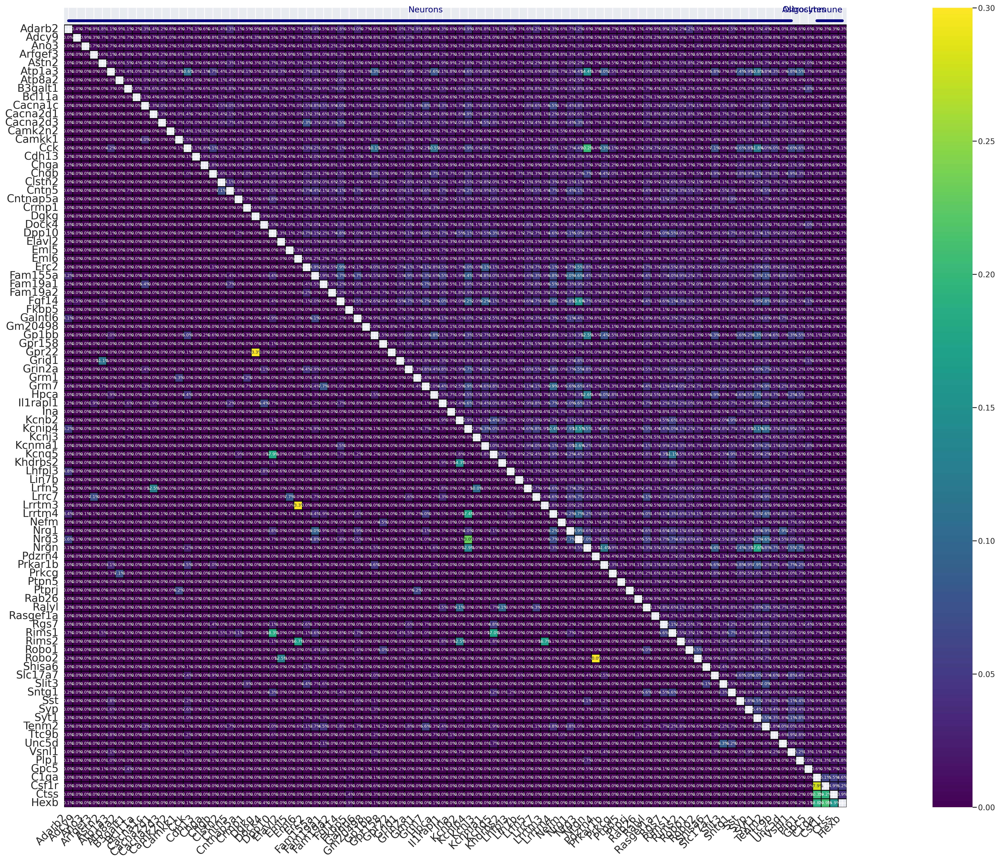

In [141]:
_utils.double_positive_pmm(adata, marker_list, marker_dict=celltype_gene_dict_sub, layer_key="generated_expression", output_dir='.')
plt.show()

In [220]:
adata.obs['neuron_positive_cells'] = adata[:, celltype_gene_dict_sub['Neurons']].layers['counts'].sum(axis=1)

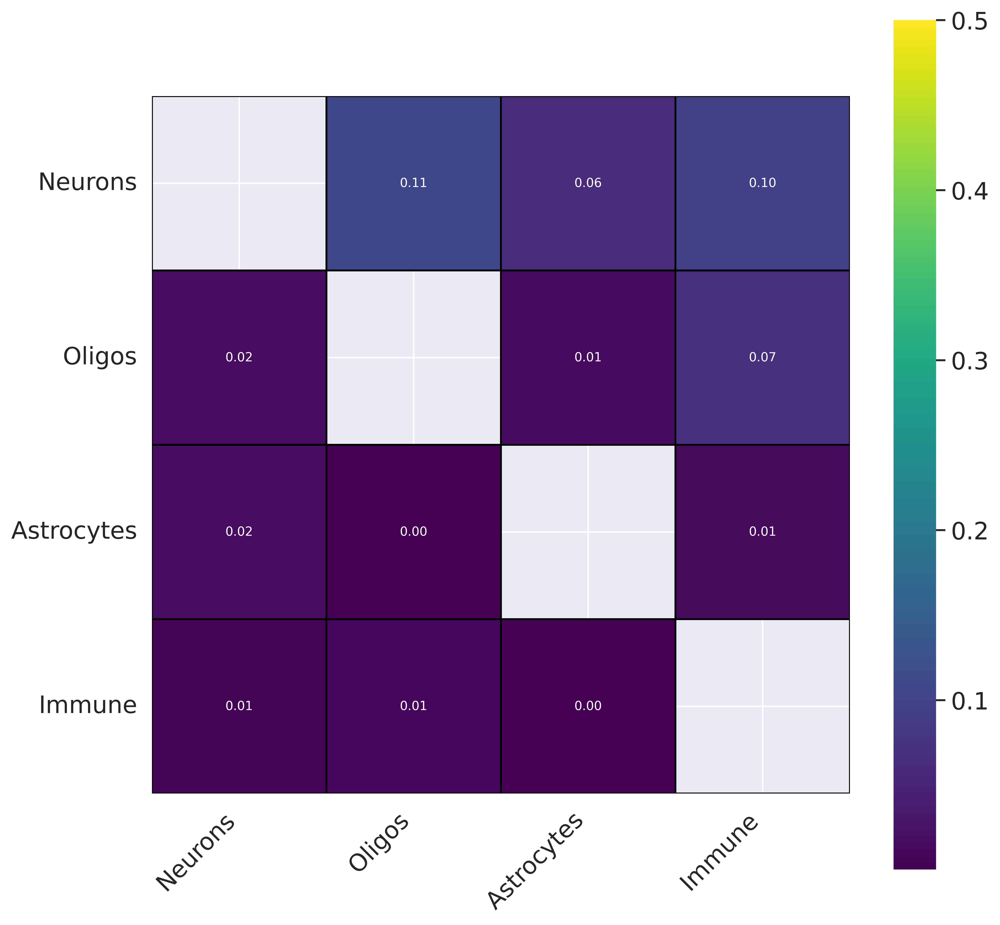

In [282]:
_utils.cosine_distance_celltype(adata, celltype_gene_dict_sub, layer_key="generated_expression", output_dir='.')
plt.show()

In [25]:
genes = ['Slc17a7', 'Slc17a6', 'Gad1', 'Gad2', 'Trem2', 'C1qa', 'Csf1r', 'Ctss', 'Gjc3', 'Mbp', 'Cldn11', 'Mobp']

In [52]:
sc.pp.log1p(adata, layer='generated_expression')
sc.pp.log1p(adata, layer='counts')

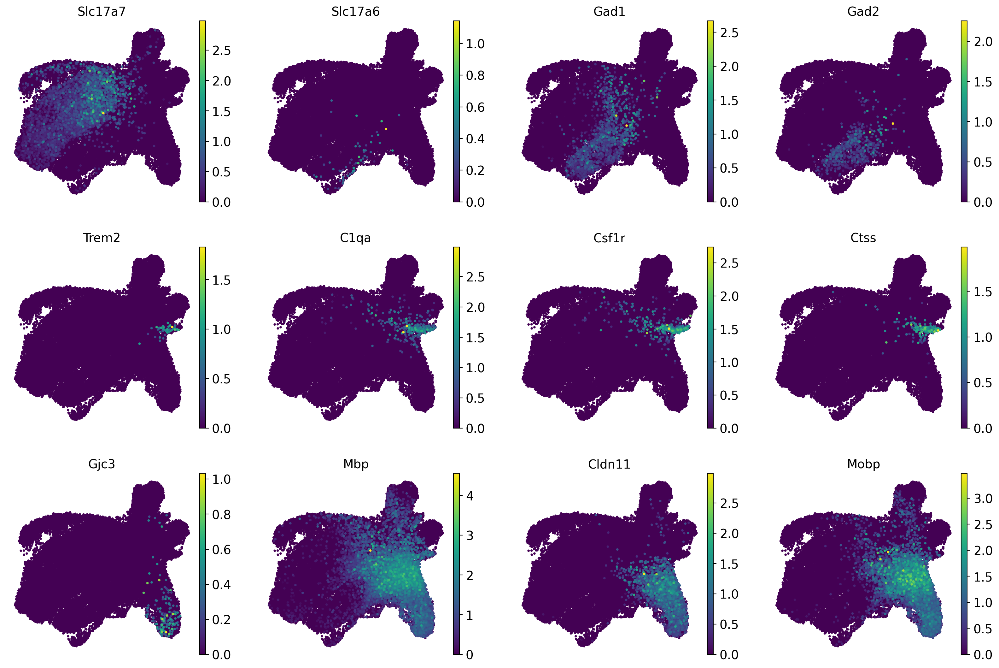

In [53]:
sc.pl.umap(adata, color=genes, size=30, layer='generated_expression', save='umap_generated.pdf', )

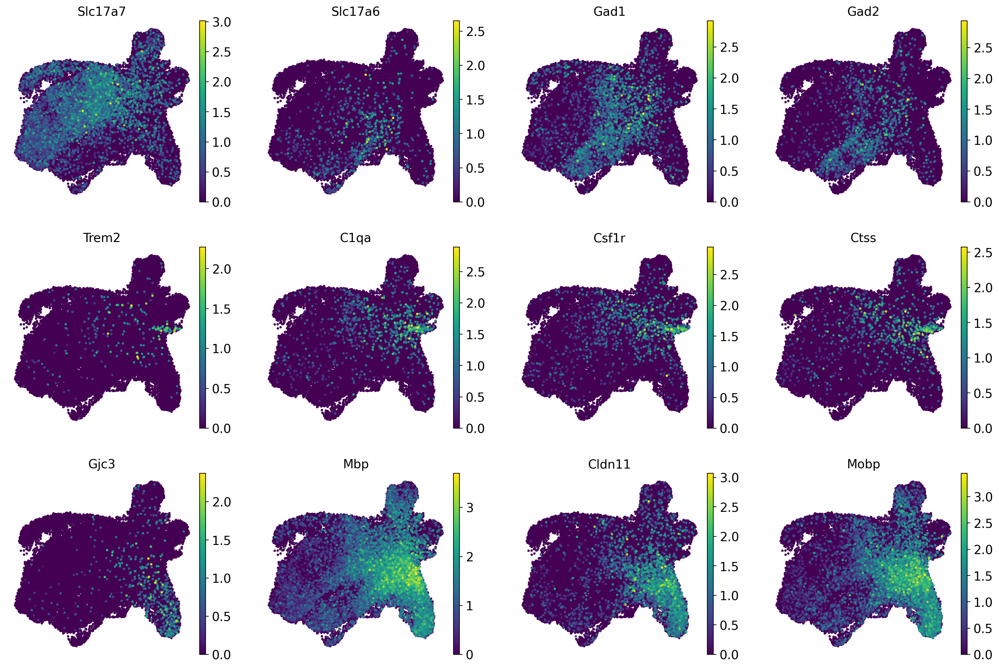

In [54]:
sc.pl.umap(adata, color=genes, size=30, layer='counts', save='umap_original.pdf')

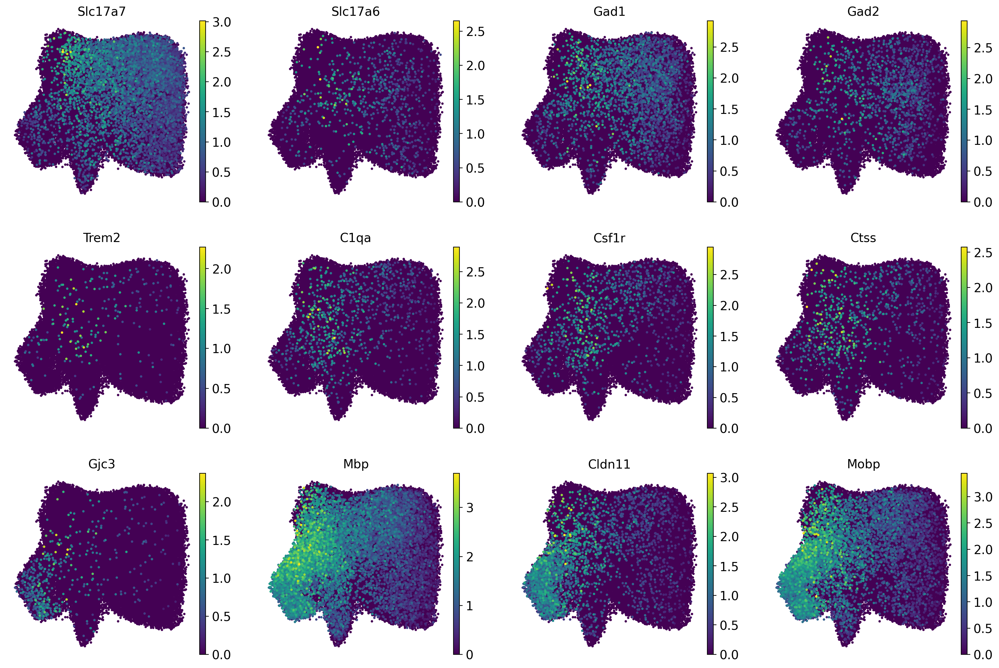

In [55]:
sc.pl.tsne(adata, color=genes, size=30, layer='counts', save='umap_original_original.pdf') # UMAP on PCA

In [301]:
adata.obsm['counts'] = pd.DataFrame(adata[:, ['Mbp', 'Slc17a7']].layers['counts'].A, columns=['Mbp', 'Slc17a7'], index=adata.obs_names)
adata.obsm['generated_expression'] = pd.DataFrame(np.array(adata[:, ['Mbp', 'Slc17a7']].layers['generated_expression']), columns=['Mbp', 'Slc17a7'], index=adata.obs_names)
_utils.double_positive_pmm(adata, marker_list=['Mbp', 'Slc17a7'],layer_key="generated_expression", output_dir='.')
plt.show()

BBB (0.19763571261493063, 0.06763589254547744, 0.010004138402576605)
BBB (0.17255339438976555, 0.0028069165302193355, 0.00012595138276625222)


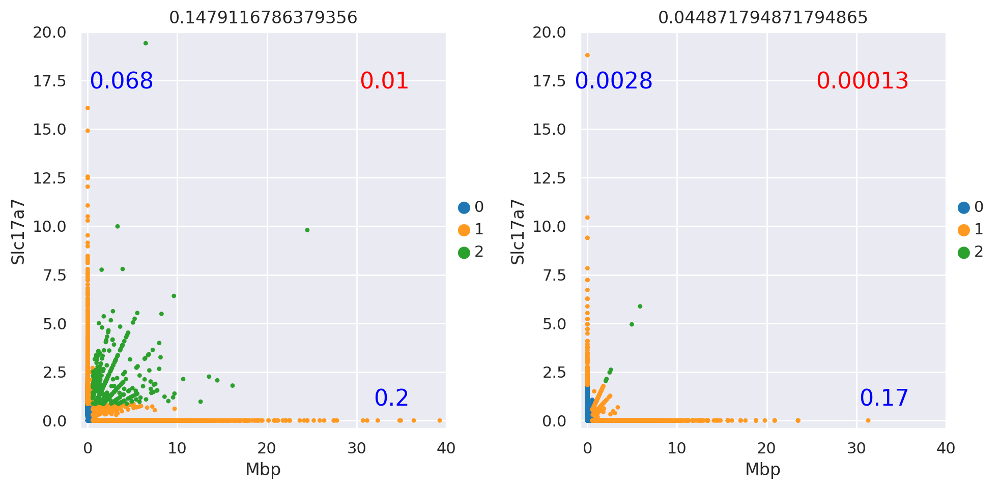

In [302]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
scatter_plots_presentation(adata, x='Mbp', y='Slc17a7', layer_key='counts', xmax=40, ymax=20, ax=ax[0])
scatter_plots_presentation(adata, x='Mbp', y='Slc17a7', layer_key='generated_expression', xmax=40, ymax=20, ax=ax[1])
plt.savefig('biaxial_generated.pdf')
plt.show()

In [270]:
adata.write_h5ad('resolvi_finished.h5ad')

In [48]:
adata = sc.read_h5ad('stereoseq/resolvi_finished.h5ad')

In [49]:
adata

AnnData object with n_obs × n_vars = 55577 × 24670
    obs: 'dnbCount', 'area', 'orig.ident', 'x', 'y', 'leiden_pca', 'counts_hvg', '_indices', '_scvi_batch', '_scvi_ind_x', '_scvi_labels', 'leiden', 'neuron_positive_cells', 'true_proportion', 'diffusion_proportion', 'background_proportion', 'double_positive'
    var: 'generated_expression'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'bin_size', 'bin_type', 'cosine_distances_ct_generated_expression', 'dendrogram_leiden', 'double_positive_colors', 'double_positive_generated_expression', 'key_record', 'leiden', 'leiden_colors', 'leiden_pca_colors', 'log1p', 'merged', 'neighbors', 'pca', 'rank_genes_groups', 'resolution', 'sn', 'umap'
    obsm: 'X_pca', 'X_resolvi', 'X_spatial', 'X_tsne', 'X_umap', 'cell_border', 'counts', 'distance_neighbor', 'generated_expression', 'index_neighbor', 'positive_pmm_counts', 'positive_pmm_generated_expression', 'spatial'
    varm: 'PCs'
    layers: 'counts', 'generated_expression', 'imputed_expression'
  